# Index

1. [Introduction](#Introduction)
2. [Imports](#Imports)
3. [Dataset](#Dataset)
4. [Preprocessing](#Preprocessing)
    1. [Text Processing](##Text-Processing)
    2. [Vectorizer and Set Separation](##Vectorizer-and-Set-Separation)
    3. [Sentiment Analysis](##Sentiment-Analysis)
    4. [Dataset Integration](##Dataset-Integration)
5. [Model Training and Classification](#Model-Training-and-Classification)
    1. [Naïve Bayes](##Naive-Bayes)
    2. [Logistic Regression](##Logistic-Regression)
    3. [Neural Network](##Neural-Network)
    3. [Support Vector Machines](##Support-Vector-Machines)
    4. [Random Forest](##Random-Forest)
    5. [AdaBoost](##AdaBoost)
    6. [One-Vs-One](##One-Vs-One)
    7. [One-Vs-All](##One-Vs-All)

# Introduction

In this notebook, we aim to develop a machine learning approach for depression detection. Our goal is to build models capable of identifying signs of depression in textual data. To achieve this, we will follow a structured approach outlined below:

1. **Preprocessing Datasets:**
    - **CEASE Dataset:** We will begin by preprocessing the CEASE dataset, which contains suicide cards annotated for depression detection. This dataset serves as our primary source for training the models.
    - **Validation and Test Datasets:** Additionally, we will preprocess validation and test datasets to assess the performance of our models beyond suicide card tests.

2. **Sentiment Analysis Coefficients:**
    - To enhance our models' understanding of textual data, we will incorporate coefficients from sentiment analysis. This involves creating a corpus of word-coefficient pairs associated with depression and assigning coefficients to words based on this corpus.

3. **Data Integration:**
    - After obtaining sentiment analysis coefficients, we will merge the CEASE dataset with the validation and test datasets to create a comprehensive dataset for model training and evaluation.

4. **Modeling and Evaluation:**
    - We will feed the merged datasets into various machine learning models, analyze their outputs, and compare their performance. Through this comparative analysis, we aim to identify the most effective model for depression detection.

By systematically following these steps, we aim to contribute to the advancement of depression detection using machine learning techniques.

# Imports

We'll start by importing the necessary libraries for our text processing, machine learning, and visualization tasks. We'll be using NLTK for text processing, scikit-learn (sklearn) for machine learning, and seaborn for visualization. With these imports, we're ready to start our text processing, machine learning, and visualization tasks using the specified libraries.

In [4]:
import os
import re
import warnings
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt 

!pip install num2words
import num2words
!pip install contractions
import contractions

import string
from string import punctuation
import unicodedata
!pip install wordcloud
from wordcloud import WordCloud

import nltk

nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('vader_lexicon')

from nltk import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer, PorterStemmer
from nltk.sentiment.vader import SentimentIntensityAnalyzer

from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn import naive_bayes
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\adria\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\adria\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\adria\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\adria\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


# Dataset

We're utilizing the CEASE dataset, a compilation of suicide notes segmented into phrases and categorized with emotions. Each file contains phrases associated with an emotion indicated by the file name. Using the os library, I've iterated through each file, extracting its contents and appending them to a list named "phrases". Additionally, I've assigned labels to each phrase to signify whether it conveys depression or not. The labeling scheme is as follows: -1 for Negative emotion, 1 for Positive emotion, and 0 for Neutral emotion.

In [5]:
# File path to the dataset
directory = os.path.join(os.path.expanduser("~"), "OneDrive", "Escritorio", "Thesis", "CEASE", "data")

# List of files names along with their corresponding emotions
file_emotions = {
    "abuse_alltext.txt": -1,  # Negative emotion
    "anger_alltext.txt": -1,  # Negative emotion
    "blame_alltext.txt": -1,  # Negative emotion
    "fear_alltext.txt": -1,  # Negative emotion
    "forgiveness_alltext.txt": 1,  # Positive emotion
    "guilt_alltext.txt": -1,  # Negative emotion
    "happiness_peacefulness_alltext.txt": 1,  # Positive emotion
    "hopefulness_alltext.txt": 1,  # Positive emotion
    "hopelessness_alltext.txt": -1,  # Negative emotion
    "information_alltext.txt": 1,  # Neutral emotion
    "instruction_alltext.txt": 1,  # Neutral emotion
    "love_alltext.txt": 1,  # Positive emotion
    "pride_alltext.txt": 1,  # Positive emotion
    "sorrow_alltext.txt": -1,  # Negative emotion
    "thankfulness_alltext.txt": 1  # Positive emotion
}

# List to store the phrases of all the files
phrases = []
# List to store the corresponding labels for each phrase
labels = []

# Go through all the files and extract the phrases along with labels
for file_name, emotion in file_emotions.items():
    file_path = os.path.join(directory, file_name)
    with open(file_path, 'r', encoding='utf-8') as file:
        file_phrases = file.readlines()
        phrases.extend(file_phrases)
        # Append the corresponding label for each phrase
        labels.extend([emotion] * len(file_phrases))

# Create a DataFrame
df = pd.DataFrame({'Text': phrases, 'label': labels})

# Print the unique labels
unique_labels = df['label'].unique()
print("Unique Labels:", unique_labels)

# Show the first phrases of the dataset along with labels
print(df.head())
print()
print("Length of the DataFrame:", len(df))

Unique Labels: [-1  1]
                                                Text  label
0  after all i was stupid to be used because i wo...     -1
1  of course ido not want to die but it is suffer...     -1
2  whatever this new accusation is it has beaten ...     -1
3  passed in great anxiety finally painted the ba...     -1
4  the most charming intelligent and important pe...     -1

Length of the DataFrame: 2393


We're preparing to incorporate a secondary dataset into our analysis—one that offers an unbiased perspective, distinct from the primary dataset derived from suicide cards. This dataset focuses on tweet emotion recognition. My intention is to meticulously process this dataset, integrating depression labels, and leverage it for both validation and testing phases of our study.

In [6]:
# Read the CSV file into a DataFrame
tweet_dataset = pd.read_csv("tweet_emotions.csv")

# Display the first few rows of the DataFrame to verify it was loaded correctly
print(tweet_dataset.head())
print("\nLength of the DataFrame:", len(tweet_dataset))

# Filter out instances with content less than 5 words
tweet_dataset = tweet_dataset[tweet_dataset['content'].apply(lambda x: len(str(x).split()) >= 5)]

# Drop rows where the sentiment column contains 'empty'
tweet_dataset = tweet_dataset[tweet_dataset['sentiment'] != 'empty']
# tweet_dataset = tweet_dataset[tweet_dataset['sentiment'] != 'neutral']

# Display the length of the updated DataFrame
print("\nLength of the Updated DataFrame:", len(tweet_dataset))

# Identify unique sentiments in the 'sentiment' column
unique_sentiments = tweet_dataset['sentiment'].unique()

# Define the dictionary mapping sentiments to labels
sentiment_labels = {
    'neutral': 1,
    'sadness': -1,
    'enthusiasm': 1,
    'worry': -1,
    'surprise': 1,
    'love': 1,
    'fun': 1,
    'hate': -1,
    'happiness': 1,
    'boredom': -1,
    'relief': 1,
    'anger': -1
}

# Apply labels to sentiments and create a new column 'sentiment_label'
tweet_dataset['sentiment_label'] = tweet_dataset['sentiment'].map(sentiment_labels)

# Drop the 'tweet_id' and 'sentiment' columns
tweet_dataset.drop(['tweet_id', 'sentiment'], axis=1, inplace=True)

# Rename the 'content' column to 'tweet_emotions' and 'sentiment_label' column to 'label'
tweet_dataset.rename(columns={'content': 'Text', 'sentiment_label': 'label'}, inplace=True)

# Display the length of the updated DataFrame
print("\nLength of the Updated DataFrame after filtering sentiment labels:", len(tweet_dataset))

# Display the updated DataFrame to verify the changes
print('\n-------------------------------------------------------------')
print('Processed Dataset:')
print(tweet_dataset.head())
print('-------------------------------------------------------------')

     tweet_id   sentiment                                            content
0  1956967341       empty  @tiffanylue i know  i was listenin to bad habi...
1  1956967666     sadness  Layin n bed with a headache  ughhhh...waitin o...
2  1956967696     sadness                Funeral ceremony...gloomy friday...
3  1956967789  enthusiasm               wants to hang out with friends SOON!
4  1956968416     neutral  @dannycastillo We want to trade with someone w...

Length of the DataFrame: 40000

Length of the Updated DataFrame: 35510

Length of the Updated DataFrame after filtering sentiment labels: 35510

-------------------------------------------------------------
Processed Dataset:
                                                Text  label
1  Layin n bed with a headache  ughhhh...waitin o...     -1
3               wants to hang out with friends SOON!      1
4  @dannycastillo We want to trade with someone w...      1
5  Re-pinging @ghostridah14: why didn't you go to...     -1
6  I should

We're preparing to add a third dataset to our analysis, which focuses on recognizing emotions in everyday phrases. We'll process this dataset, add depression labels, and use it for validation and testing in our study.

In [7]:
# Read the CSV file into a DataFrame
emotion_dataset = pd.read_csv("Emotion-Detection-in-Text-main/data/emotion_dataset_raw.csv")

# Display the first few rows of the DataFrame to verify it was loaded correctly
print(emotion_dataset.head())
print("\nLength of the DataFrame:", len(emotion_dataset))

# Filter out instances with content less than 5 words
emotion_dataset = emotion_dataset[emotion_dataset['Text'].apply(lambda x: len(str(x).split()) >= 5)]

# Drop rows where the sentiment column contains 'empty'
emotion_dataset = emotion_dataset.dropna()

# Display the length of the updated DataFrame
print("\nLength of the Updated DataFrame:", len(emotion_dataset))

# Identify unique emotions in the 'Emotion' column
unique_emotions = emotion_dataset['Emotion'].unique()

# Define the dictionary mapping emotions to labels
emotion_labels = {
    'neutral': 1,
    'joy': 1,
    'sadness': -1,
    'fear': -1,
    'surprise': 1,
    'anger': -1,
    'shame': -1,
    'disgust': -1,
}

# Apply labels to emotions and create a new column 'label'
emotion_dataset['label'] = emotion_dataset['Emotion'].map(emotion_labels)

# Drop the 'Emotion' column
emotion_dataset.drop(['Emotion'], axis=1, inplace=True)

# Display the updated DataFrame to verify the changes
print('\n-------------------------------------------------------------')
print('Processed Dataset:')
print(emotion_dataset.head())
print('-------------------------------------------------------------')

   Emotion                                               Text
0  neutral                                             Why ? 
1      joy    Sage Act upgrade on my to do list for tommorow.
2  sadness  ON THE WAY TO MY HOMEGIRL BABY FUNERAL!!! MAN ...
3      joy   Such an eye ! The true hazel eye-and so brill...
4      joy  @Iluvmiasantos ugh babe.. hugggzzz for u .!  b...

Length of the DataFrame: 34792

Length of the Updated DataFrame: 32680

-------------------------------------------------------------
Processed Dataset:
                                                Text  label
1    Sage Act upgrade on my to do list for tommorow.      1
2  ON THE WAY TO MY HOMEGIRL BABY FUNERAL!!! MAN ...     -1
3   Such an eye ! The true hazel eye-and so brill...      1
4  @Iluvmiasantos ugh babe.. hugggzzz for u .!  b...      1
5  I'm expecting an extremely important phonecall...     -1
-------------------------------------------------------------


We'll create word clouds for each dataset to visually identify the most frequent words. This analysis will offer insights into the predominant themes and language patterns within each dataset. By examining the word clouds, we can anticipate the composition of the data and infer potential challenges or biases that might influence model precision. This exploration is crucial for understanding the data characteristics and guiding the development of effective predictive models.

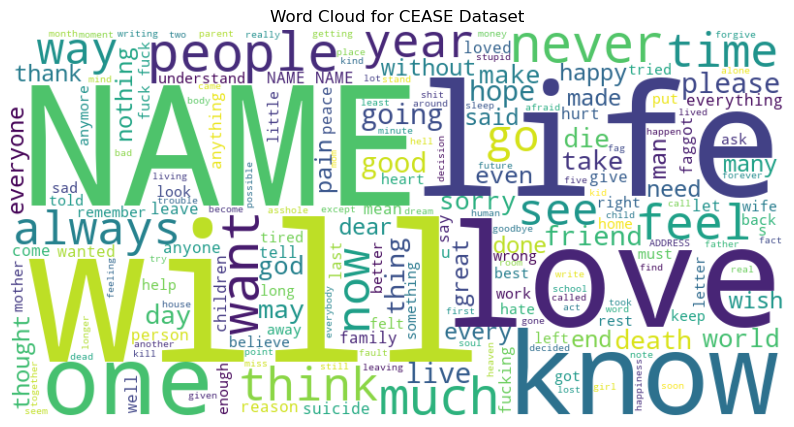

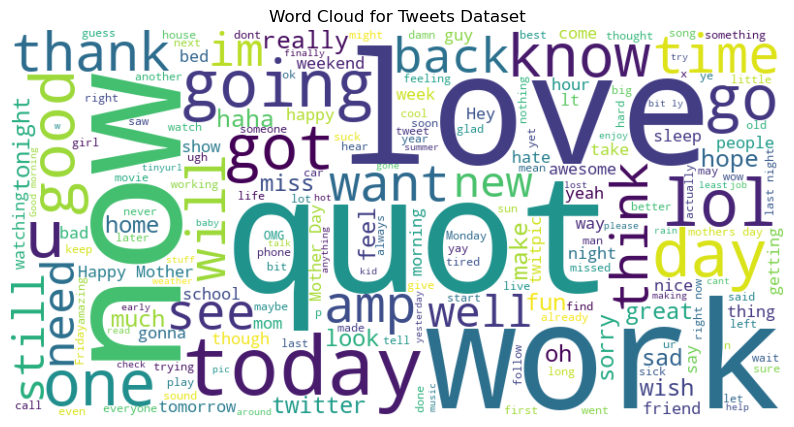

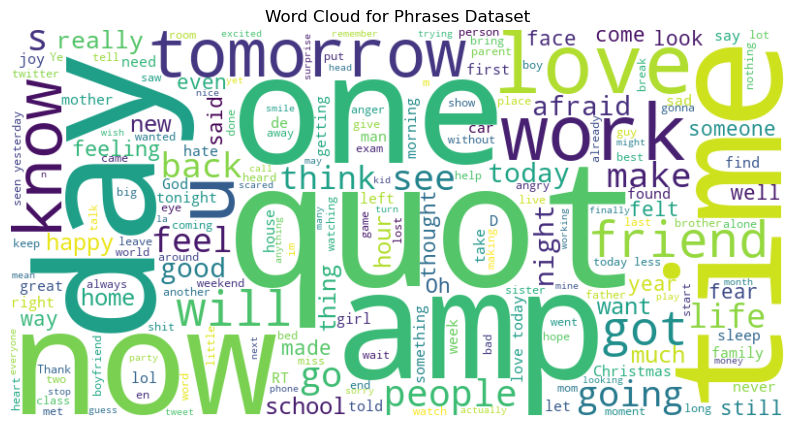

In [8]:
# Function to generate word clouds for each dataset
def generate_wordcloud(dataset, dataset_name):
    # Concatenate all text data in the dataset
    text = ' '.join(dataset['Text'])

    # Generate word cloud
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

    # Plot word cloud
    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f"Word Cloud for {dataset_name}")
    plt.axis('off')
    plt.show()

# Generate word clouds for each dataset
generate_wordcloud(df, 'CEASE Dataset')
generate_wordcloud(tweet_dataset, 'Tweets Dataset')
generate_wordcloud(emotion_dataset, 'Phrases Dataset')

# Preprocessing
## Text Processing

Below are the preprocessing functions I've developed. Here's a breakdown of the preprocessing steps:

1. Remove Non-ASCII Characters: Eliminate non-ASCII characters from the text.
2. Convert to Lowercase: Change all text to lowercase for uniformity.
3. Remove Punctuation: Strip punctuation marks from the words.
4. Replace Numbers: Convert numeric values to their textual representation.
5. Remove Stopwords: Filter out stopwords, which are words that don't influence the model's understanding.
6. Lemmatize: Obtain the lemma of each word to reduce it to its semantic root.
7. Stemmatize: Shorten words to their semantic root.
8. Remove Consecutive Characters: Delete consecutive characters that appear three or more times in a word.

In [9]:
def remove_non_ascii(text):
    # Removes non-ASCII characters from a list of tokenized words
    return [word.encode('ascii', 'ignore').decode() for word in text]

def to_lowercase(text):
    # Converts all words to lowercase in a list of tokenized words
    return [word.lower() for word in text]
    
def remove_punctuation(text):
    # Removes punctuation from a list of tokenized words
    new_text = []
    for word in text:
        new_word = re.sub(r'[^\w\s]', '', word)
        if new_word != '':
            new_text.append(new_word)
    return new_text

def replace_numbers(text):
    # Replaces all occurrences of numbers with their textual representation in a list of tokenized words
    return [num2words.num2words(word, lang='en') if (word.isnumeric() or word.isdecimal()) else word for word in text]

def remove_stopwords(words):
    # Removes stopwords (words that do not influence the model) from a list of tokenized words
    stop_words = stopwords.words("english")
    return [token for token in words if token.lower() not in stop_words]

def lemmatize(text):
    # Lemmatizes words in each text
    # This involves obtaining the lemma of the corresponding word. This lemma is common to words of the same semantic root.
    # EXAMPLE: words like "eating" and "eats" when lemmatized would yield "eat"
    lemmatizer = WordNetLemmatizer()
    return [lemmatizer.lemmatize(word) for word in text]

def stemmatize(text):
    # Stems words in each text
    # This involves shortening words to their semantic root.
    # EXAMPLE: words like "eating" and "eats" when stemmed would yield "eat" or "eat"
    stemmer = PorterStemmer()
    return [stemmer.stem(word) for word in text]

def remove_url(text):
    # Removes URLs from a list of tokenized words
    new_text = []
    for word in text:
        new_word = re.sub(r'http://\S+', '', word)
        new_text.append(new_word)
    return new_text

def remove_consecutive_characters(text):
    # Removes consecutive characters that appear three or more times in a word
    # This is done for a list of tokenized words
    new_text = []
    for word in text:
        new_text.append(re.sub(r'(.)\1{2,}', r'\1', word))
    return new_text

def remove_usernames(text):
    # Removes usernames appearing in a list of tokenized words
    new_text = []
    for word in text:
        new_text.append(re.sub('USERNAME_TOKEN', "", word))
    return new_text

def remove_frequent_words(text):
    # Removes frequently occurring words from a list of tokenized words
    frequent_words = ['name', 'quot', 'amp']
    return [word for word in text if word not in frequent_words]

def normalize(text):
    # Given a list of tokenized words, normalize them for effective learning
    # new_text = remove_url(text)
    # new_text = remove_usernames(new_text)
    new_text = remove_non_ascii(text)
    new_text = remove_usernames(new_text)
    new_text = remove_url(new_text)
    new_text = to_lowercase(new_text)
    new_text = remove_punctuation(new_text)
    new_text = replace_numbers(new_text)
    new_text = remove_consecutive_characters(new_text)
    new_text = remove_stopwords(new_text)
    new_text = remove_frequent_words(new_text)
    return new_text

In [10]:
########################## CEASE DATASET ##########################

# Example usage with CEASE dataset
X_lemmatized = []

# Loop through each entry in the CEASE dataset
for index, row in df.iterrows():
    # Fix contractions in the text
    word_without_contractions = contractions.fix(row['Text'])
    print(word_without_contractions)
    
    # Replace usernames with a special token that preserves the '@' symbol
    word_without_usernames = re.sub(r'@(\w+)', r'USERNAME_TOKEN', word_without_contractions)
    print(word_without_usernames)
    
    # Tokenize the text into words
    tokenized = word_tokenize(word_without_usernames)
    print(tokenized)
    
    # Normalize the tokenized text, excluding the special token for usernames
    normalized = normalize(tokenized)
    print(normalized)
    
    # Lemmatize the normalized text
    lemmatized = lemmatize(normalized)
    print(lemmatized)

    # Join the normalized words into a single string and append to X_lemmatized list
    X_lemmatized.append(" ".join(normalized))

# Convert the list of normalized texts into a numpy array with dtype 'str'
X_lemmatized = np.array(X_lemmatized, dtype=str)
print(X_lemmatized)

after all i was stupid to be used because i worked hard to adjust myself to the atmosphere in the presidents room under the direction of the director .

after all i was stupid to be used because i worked hard to adjust myself to the atmosphere in the presidents room under the direction of the director .

['after', 'all', 'i', 'was', 'stupid', 'to', 'be', 'used', 'because', 'i', 'worked', 'hard', 'to', 'adjust', 'myself', 'to', 'the', 'atmosphere', 'in', 'the', 'presidents', 'room', 'under', 'the', 'direction', 'of', 'the', 'director', '.']
['stupid', 'used', 'worked', 'hard', 'adjust', 'atmosphere', 'presidents', 'room', 'direction', 'director']
['stupid', 'used', 'worked', 'hard', 'adjust', 'atmosphere', 'president', 'room', 'direction', 'director']
of course ido not want to die but it is suffering to live .

of course ido not want to die but it is suffering to live .

['of', 'course', 'ido', 'not', 'want', 'to', 'die', 'but', 'it', 'is', 'suffering', 'to', 'live', '.']
['course', 'id

In [11]:
########################## TWEET EMOTIONS DATASET ##########################

# Example usage with Tweet Emotions dataset
X_lemmatized_tweets = []

# Loop through each entry in the Tweet Emotions dataset
for index, row in tweet_dataset.iterrows():
    # Fix contractions in the text
    word_without_contractions = contractions.fix(row['Text'])
    print(word_without_contractions)
    
    # Replace usernames with a special token that preserves the '@' symbol
    word_without_usernames = re.sub(r'@(\w+)', r'USERNAME_TOKEN', word_without_contractions)
    print(word_without_usernames)
    
    # Tokenize the text into words
    tokenized = word_tokenize(word_without_usernames)
    print(tokenized)

    # Normalize the tokenized text
    normalized = normalize(tokenized)
    print(normalized)

    # Lemmatize the normalized text
    lemmatized = lemmatize(normalized)
    print(lemmatized)

    # Join the lemmatized words into a single string and append to X_lemmatized_tweets list
    X_lemmatized_tweets.append(" ".join(lemmatized))

# Convert the list of lemmatized texts into a numpy array with dtype 'str'
X_lemmatized_tweets = np.array(X_lemmatized_tweets, dtype=str)
print(X_lemmatized_tweets)

Layin n bed with a headache  ughhhh...waitin on your call...
Layin n bed with a headache  ughhhh...waitin on your call...
['Layin', 'n', 'bed', 'with', 'a', 'headache', 'ughhhh', '...', 'waitin', 'on', 'your', 'call', '...']
['layin', 'n', 'bed', 'headache', 'ugh', 'waitin', 'call']
['layin', 'n', 'bed', 'headache', 'ugh', 'waitin', 'call']
wants to hang out with friends SOON!
wants to hang out with friends SOON!
['wants', 'to', 'hang', 'out', 'with', 'friends', 'SOON', '!']
['wants', 'hang', 'friends', 'soon']
['want', 'hang', 'friend', 'soon']
@dannycastillo We want to trade with someone who has Houston tickets, but no one will.
USERNAME_TOKEN We want to trade with someone who has Houston tickets, but no one will.
['USERNAME_TOKEN', 'We', 'want', 'to', 'trade', 'with', 'someone', 'who', 'has', 'Houston', 'tickets', ',', 'but', 'no', 'one', 'will', '.']
['want', 'trade', 'someone', 'houston', 'tickets', 'one']
['want', 'trade', 'someone', 'houston', 'ticket', 'one']
Re-pinging @ghostr

In [12]:
########################## PHRASES EMOTIONS DATASET ##########################

# Example usage with Tweet Emotions dataset
X_lemmatized_emotions = []

# Loop through each entry in the Tweet Emotions dataset
for index, row in emotion_dataset.iterrows():
    # Fix contractions in the text
    word_without_contractions = contractions.fix(row['Text'])
    print(word_without_contractions)

    # Replace usernames with a special token that preserves the '@' symbol
    word_without_usernames = re.sub(r'@(\w+)', r'USERNAME_TOKEN', word_without_contractions)
    print(word_without_usernames)
    
    # Tokenize the text into words
    tokenized = word_tokenize(word_without_usernames)
    print(tokenized)

    # Normalize the tokenized text
    normalized = normalize(tokenized)
    print(normalized)

    # Lemmatize the normalized text
    lemmatized = lemmatize(normalized)
    print(lemmatized)

    # Join the lemmatized words into a single string and append to X_lemmatized_tweets list
    X_lemmatized_emotions.append(" ".join(lemmatized))

# Convert the list of lemmatized texts into a numpy array with dtype 'str'
X_lemmatized_emotions = np.array(X_lemmatized_emotions, dtype=str)
print(X_lemmatized_emotions)

Sage Act upgrade on my to do list for tommorow.
Sage Act upgrade on my to do list for tommorow.
['Sage', 'Act', 'upgrade', 'on', 'my', 'to', 'do', 'list', 'for', 'tommorow', '.']
['sage', 'act', 'upgrade', 'list', 'tommorow']
['sage', 'act', 'upgrade', 'list', 'tommorow']
ON THE WAY TO MY HOMEGIRL BABY FUNERAL!!! MAN I HATE FUNERALS THIS REALLY SHOWS ME HOW BLESSED I AM 
ON THE WAY TO MY HOMEGIRL BABY FUNERAL!!! MAN I HATE FUNERALS THIS REALLY SHOWS ME HOW BLESSED I AM 
['ON', 'THE', 'WAY', 'TO', 'MY', 'HOMEGIRL', 'BABY', 'FUNERAL', '!', '!', '!', 'MAN', 'I', 'HATE', 'FUNERALS', 'THIS', 'REALLY', 'SHOWS', 'ME', 'HOW', 'BLESSED', 'I', 'AM']
['way', 'homegirl', 'baby', 'funeral', 'man', 'hate', 'funerals', 'really', 'shows', 'blessed']
['way', 'homegirl', 'baby', 'funeral', 'man', 'hate', 'funeral', 'really', 'show', 'blessed']
 Such an eye ! The true hazel eye-and so brilliant ! Regular features , open countenance , with a complexion , Oh ! What a bloom of full health , and such a prett

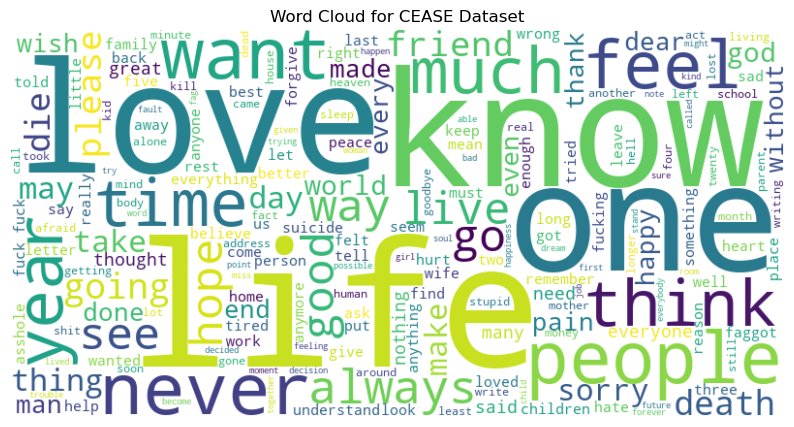

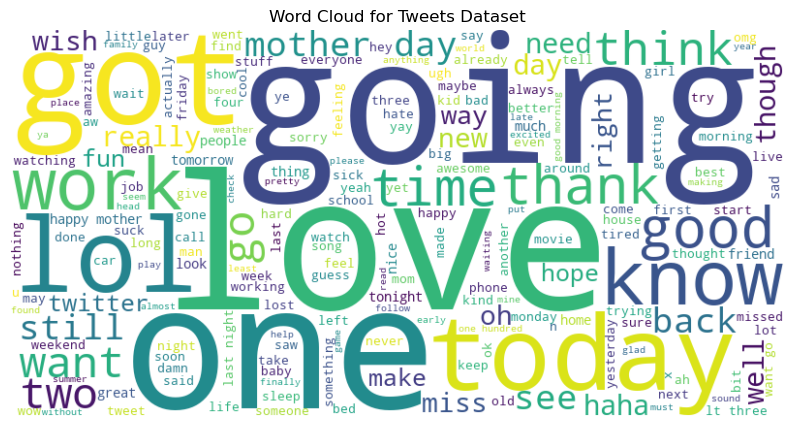

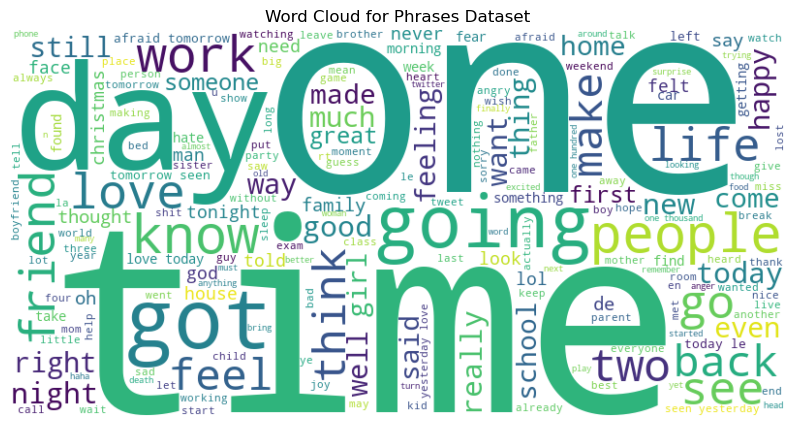

In [13]:
# Function to generate word clouds for each dataset
def generate_wordcloud(dataset, dataset_name):
    # Concatenate all text data in the dataset
    text = ' '.join(dataset['Text'])

    # Generate word cloud
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

    # Plot word cloud
    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f"Word Cloud for {dataset_name}")
    plt.axis('off')
    plt.show()

# Generate word clouds for each dataset
df_lemmatized = pd.DataFrame({'Text': X_lemmatized})
generate_wordcloud(df_lemmatized, 'CEASE Dataset')
df_lemmatized_tweets = pd.DataFrame({'Text': X_lemmatized_tweets})
generate_wordcloud(df_lemmatized_tweets, 'Tweets Dataset')
df_lemmatized_emotions = pd.DataFrame({'Text': X_lemmatized_emotions})
generate_wordcloud(df_lemmatized_emotions, 'Phrases Dataset')

## Vectorizer and Set Separation

We utilize the CountVectorizer and TfidfVectorizer to transform words into numerical representations, enabling the model to learn from the dataset. The dataset is split into training (70%) and test (30%) sets. This code efficiently prepares the dataset for training, ensuring that the model has enough data to learn from while also providing validation and test sets for evaluation.

In [14]:
########################## CEASE DATASET ##########################

# Split the dataset into train (70%), test (30%)
X_train, X_test, y_train, y_test = train_test_split(X_lemmatized, labels, test_size=0.3, random_state=42)

# Check the shapes of the resulting sets
print("Train set shape:", X_train.shape)
print("Test set shape:", X_test.shape)

# Check the shapes of the resulting sets
print("Train set shape:", len(y_train))
print("Test set shape:", len(y_test))

Train set shape: (1675,)
Test set shape: (718,)
Train set shape: 1675
Test set shape: 718


In [15]:
# ########################## TWEET EMOTIONS DATASET ##########################

# Extract labels from the 'label' column in the Tweet Emotions dataset
labels_tweets = tweet_dataset['label']

In [16]:
# ########################## TWEET EMOTIONS DATASET ##########################

# Extract labels from the 'label' column in the Tweet Emotions dataset
labels_emotions = emotion_dataset['label']

# Model Training and Classification

In this section, we will delve into the core of our machine learning approach for depression detection. Here, we will train various models using our preprocessed datasets and evaluate their performance using the confusion matrix as our primary analytical tool. The confusion matrix provides a clear and comprehensive visualization of the model's classification results, allowing us to assess its effectiveness in distinguishing between depressed and non-depressed texts. By leveraging the confusion matrix, we gain insights into the model's true positives, true negatives, false positives, and false negatives, enabling us to identify areas for improvement and fine-tune our approach. Moreover, the confusion matrix allows us to calculate performance metrics such as accuracy, precision, recall, and F1 score, providing a holistic understanding of the model's classification capabilities. Overall, by utilizing the confusion matrix, we can make informed decisions regarding model selection, parameter tuning, and optimization strategies, ultimately enhancing the accuracy and reliability of our depression detection system.

In [17]:
# To visualize a comparison table of precisions, we will use a pandas DataFrame.
# This is the initialization of the DataFrame.
columns_train = []
columns_cease = []
columns_tweets = []
columns_phrases = []
column_names = ['Classifier', 'Accuracy', 'Precision', 'Recall', 'F1-score', 'Roc-Auc_Score']

In [18]:
# We will also use confusion matrices to display the number of correct predictions per class.
# Here is the function that will display the confusion matrix given the model outputs and the true classes.

def showConfusionMatrix(y_true, y_pred, classifier):
    # Display the confusion matrix
    # print('Confusion matrix of the classifier:', classifier)
    class_names = [1, -1]
    cm = confusion_matrix(y_true, y_pred, labels=[1, -1])
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
    fig, ax = plt.subplots()
    ax.set_title(classifier)
    disp.plot(ax=ax)

def plot_confusion_matrices(confusion_matrices, titles):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    for i, (cm, title) in enumerate(zip(confusion_matrices, titles)):
        axes[i].imshow(cm, interpolation='nearest', cmap='Blues')
        axes[i].set_title(title)
        axes[i].set_xlabel('Predicted')
        axes[i].set_ylabel('Actual')
        for j in range(cm.shape[0]):
            for k in range(cm.shape[1]):
                axes[i].text(k, j, str(cm[j, k]), ha='center', va='center', color='black')
    plt.tight_layout()
    plt.show()


In [19]:
def evaluate_model(cease_outputs, best_model, name):
    # Initialize lists
    columns_cease = []
    columns_tweets = []
    columns_phrases = []
    column_names = ['Classifier', 'Accuracy', 'Precision', 'Recall', 'F1-score', 'Roc-Auc_Score']
    
    # Obtain outputs for testing instances from CEASE dataset
    tweets_outputs = best_model.predict(X_lemmatized_tweets)
    
    # Obtain outputs for testing instances from tweets dataset
    tweets_outputs = best_model.predict(X_lemmatized_tweets)
    
    # Obtain outputs for testing instances from phrases dataset
    emotions_outputs = best_model.predict(X_lemmatized_emotions)
    
    # Compute metrics
    # Accuracy
    accuracy_cease = metrics.accuracy_score(y_test, cease_outputs)
    accuracy_tweets = metrics.accuracy_score(labels_tweets, tweets_outputs)
    accuracy_phrases = metrics.accuracy_score(labels_emotions, emotions_outputs)

    # Precision
    precision_cease = metrics.precision_score(y_test, cease_outputs)
    precision_tweets = metrics.precision_score(labels_tweets, tweets_outputs)
    precision_phrases = metrics.precision_score(labels_emotions, emotions_outputs)

    # Recall
    recall_cease = metrics.recall_score(y_test, cease_outputs)
    recall_tweets = metrics.recall_score(labels_tweets, tweets_outputs)
    recall_phrases = metrics.recall_score(labels_emotions, emotions_outputs)

    # F1 Score
    f1_cease = metrics.f1_score(y_test, cease_outputs)
    f1_tweets = metrics.f1_score(labels_tweets, tweets_outputs)
    f1_phrases = metrics.f1_score(labels_emotions, emotions_outputs)

    # ROC Curve and AUC
    fpr_cease, tpr_cease, _ = metrics.roc_curve(y_test, cease_outputs)
    auc_cease = metrics.roc_auc_score(y_test, cease_outputs)

    fpr_tweets, tpr_tweets, _ = metrics.roc_curve(labels_tweets, tweets_outputs)
    auc_tweets = metrics.roc_auc_score(labels_tweets, tweets_outputs)

    fpr_phrases, tpr_phrases, _ = metrics.roc_curve(labels_emotions, emotions_outputs)
    auc_phrases = metrics.roc_auc_score(labels_emotions, emotions_outputs)

    # Store metrics in corresponding lists
    columns_cease.append([name, accuracy_cease, precision_cease, recall_cease, f1_cease, auc_cease])
    columns_tweets.append([name, accuracy_tweets, precision_tweets, recall_tweets, f1_tweets, auc_tweets])
    columns_phrases.append([name, accuracy_phrases, precision_phrases, recall_phrases, f1_phrases, auc_phrases])

    # Create DataFrame
    df_cease = pd.DataFrame(columns_cease, columns=column_names)
    df_tweets = pd.DataFrame(columns_tweets, columns=column_names)
    df_phrases = pd.DataFrame(columns_phrases, columns=column_names)

    # Combine all dataframes into one
    df_metrics = pd.concat([df_cease, df_tweets, df_phrases], ignore_index=True)

    print(df_metrics)

    # Plot ROC Curve
    plt.figure(figsize=(10, 6))
    plt.plot(fpr_cease, tpr_cease, linestyle='-', label=name + ' CEASE (AUC = {:.2f})'.format(auc_cease))
    plt.plot(fpr_tweets, tpr_tweets, linestyle='-', label=name + ' Tweets (AUC = {:.2f})'.format(auc_tweets))
    plt.plot(fpr_phrases, tpr_phrases, linestyle='-', label=name + ' Phrases (AUC = {:.2f})'.format(auc_phrases))
    plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Random Guessing')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Make the confusion matrices
    cm_cease = metrics.confusion_matrix(y_test, cease_outputs, labels=[1, -1])
    cm_tweets = metrics.confusion_matrix(labels_tweets, tweets_outputs, labels=[1, -1])
    cm_phrases = metrics.confusion_matrix(labels_emotions, emotions_outputs, labels=[1, -1])

    # Example confusion matrices and titles
    confusion_matrices = [cm_cease, cm_tweets, cm_phrases]
    titles = [name+' CEASE', name+' Tweets', name+' Phrases']
    # Plot confusion matrices
    plot_confusion_matrices(confusion_matrices, titles)
    
    return df_cease, df_tweets, df_phrases, df_metrics


## Naïve Bayes

Naïve Bayes is a probabilistic classifier based on Bayes' theorem with strong independence assumptions between features. It's simple yet effective for text classification tasks, making it suitable for our depression detection problem.

In [20]:
def train_test_model_naive_bayes(model, X_train, y_train, X_test, y_test):    
    # Define a pipeline with preprocessing and the model
    pipeline = Pipeline([
        ('vectorizer', TfidfVectorizer()),
        ('model', model)
    ])
    
    # Parameters for GridSearch
    parameters = {
        'model__alpha': [0.1, 0.5, 1.0],
        'model__fit_prior': [True, False],
        'vectorizer__max_features': [1000, 5000],
        'vectorizer__ngram_range': [(1, 1), (1, 2)],
    }
    
    # Set up the grid search with cross-validation
    grid_search = GridSearchCV(pipeline, parameters, cv=5, n_jobs=-1)
    
    # Train the model
    grid_search.fit(X_train, y_train)
    
    # Obtain best model from grid search
    best_model = grid_search.best_estimator_
    
    # Obtain outputs for testing instances
    test_outputs = best_model.predict(X_test)
    
    return test_outputs, best_model

    Classifier  Accuracy  Precision    Recall  F1-score  Roc-Auc_Score
0  Naive Bayes  0.764624   0.769115  0.971591  0.858577       0.580532
1  Naive Bayes  0.608110   0.609150  0.967945  0.747734       0.518120
2  Naive Bayes  0.495594   0.485503  0.971566  0.647461       0.516748


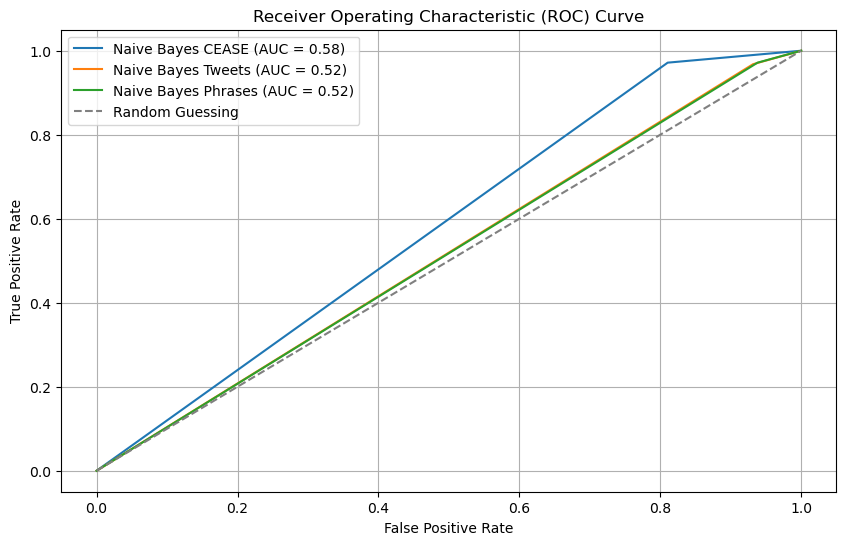

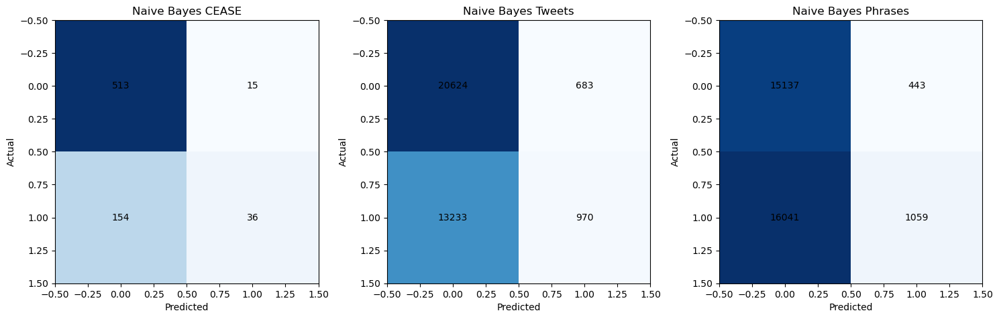

In [21]:
# Call the function for CEASE dataset
cease_outputs, best_model = train_test_model_naive_bayes(naive_bayes.MultinomialNB(), X_train, y_train, X_test, y_test)

# Call the function to print all the metrics and visualizations
df_cease_naive, df_tweets_naive, df_phrases_naive, df_metrics_naive = evaluate_model(cease_outputs, best_model, 'Naive Bayes')

## Logistic Regression

Logistic Regression is a linear classifier that predicts the probability of a binary outcome based on one or more predictor variables. Despite its name, it's used for classification tasks, not regression. It's interpretable and efficient, making it a popular choice for binary classification problems like depression detection.

In [22]:
# This function will obtain the best parameters for logistic regression
# Also, it calculates the training, validation, and test accuracies of the best model
def train_test_logistic_regression(X_train, y_train, X_test, y_test):
    # Define a pipeline with preprocessing and the logistic regression model
    pipeline = Pipeline([
        ('vectorizer', TfidfVectorizer()), 
        ('model', LogisticRegression())
    ])

    # Parameters for GridSearch with CountVectorizer
    parameters = {
        'vectorizer__max_features': [1000, 5000],
        'vectorizer__ngram_range': [(1, 1), (1, 2)],
        'model__C': [0.01, 0.03, 0.1, 0.3, 1],
        'model__solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag']
    }

    # Set up the grid search with cross-validation
    grid_search = GridSearchCV(pipeline, parameters, cv=5, n_jobs=-1)

    # Train the model
    grid_search.fit(X_train, y_train)

    # Obtain best model from grid search
    best_model = grid_search.best_estimator_

    # Obtain outputs for testing instances
    test_outputs = best_model.predict(X_test)

    return test_outputs, best_model

            Classifier  Accuracy  Precision    Recall  F1-score  Roc-Auc_Score
0  Logistic Regression  0.760446   0.757225  0.992424  0.859016       0.554107
1  Logistic Regression  0.608110   0.609150  0.967945  0.747734       0.518120
2  Logistic Regression  0.495594   0.485503  0.971566  0.647461       0.516748


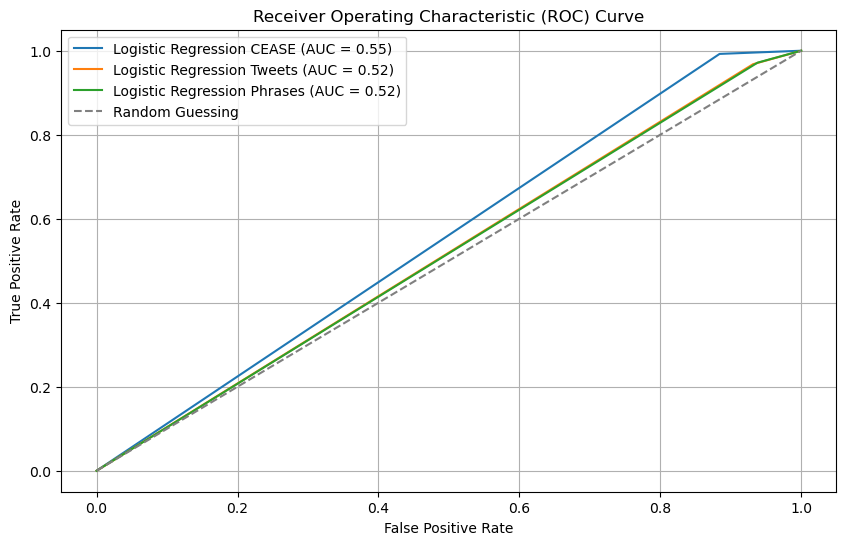

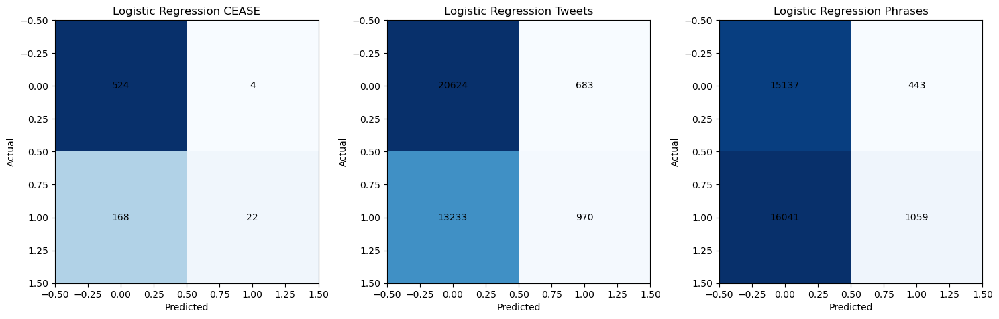

In [23]:
# Call the function for CEASE dataset
cease_outputs, best_model_logistic = train_test_logistic_regression(X_train, y_train, X_test, y_test)

# Call the function to print all the metrics and visualizations
df_cease_logistic, df_tweets_logistic, df_phrases_logistic, df_metrics_logistic = evaluate_model(cease_outputs, best_model, 'Logistic Regression')

## Neural Networks

Neural Networks are a class of machine learning models inspired by the structure and function of the human brain. They consist of interconnected layers of nodes (neurons) that learn to map input data to output predictions through a process called backpropagation. Neural networks can capture complex patterns in data, making them powerful tools for various tasks, including depression detection.

In [24]:
def train_test_neural_network(X_train, y_train, X_test, y_test):
    # Define a pipeline with preprocessing and the neural network model
    pipeline = Pipeline([
        ('vectorizer', TfidfVectorizer()),
        ('model', MLPClassifier())
    ])

    # Parameters for GridSearch with CountVectorizer
    parameters = {
        'vectorizer__max_features': [1000],
        'vectorizer__ngram_range': [(1, 1), (1, 2)],
        'model__hidden_layer_sizes': [(50,), (100,)],
        'model__activation': ['relu', 'tanh'],
        'model__solver': ['adam', 'sgd'],
        'model__alpha': [0.0001, 0.001],
        'model__max_iter': [200],
        'model__early_stopping': [True],
        'model__validation_fraction': [0.1],
        'model__batch_size': [32, 64]
    }

    # Set up the grid search with cross-validation
    grid_search = GridSearchCV(pipeline, parameters, cv=5, n_jobs=-1)

    # Train the model
    grid_search.fit(X_train, y_train)

    # Obtain best model from grid search
    best_model = grid_search.best_estimator_

    # Obtain outputs for testing instances
    test_outputs = best_model.predict(X_test)

    return test_outputs, best_model

        Classifier  Accuracy  Precision    Recall  F1-score  Roc-Auc_Score
0  Neural Networks  0.739554   0.739803  0.996212  0.849072       0.511264
1  Neural Networks  0.602563   0.601794  0.998029  0.750843       0.503661
2  Neural Networks  0.479621   0.478097  0.998909  0.646680       0.502700


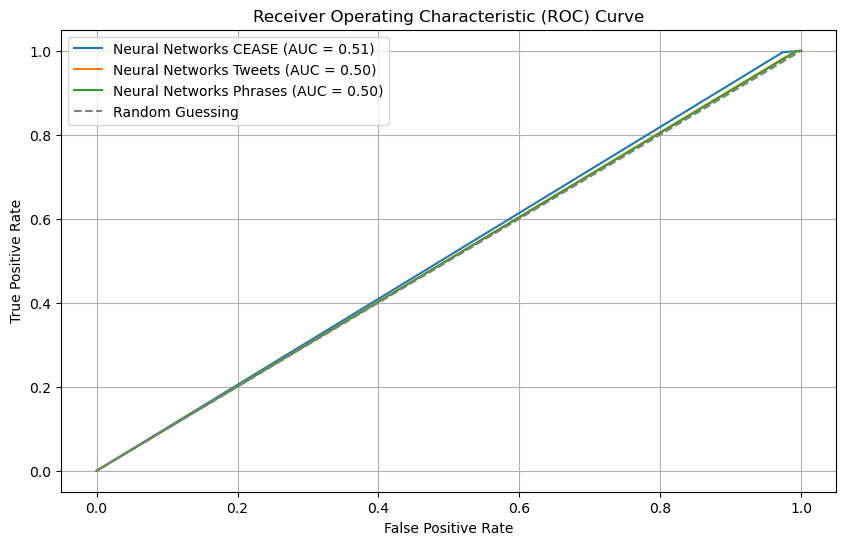

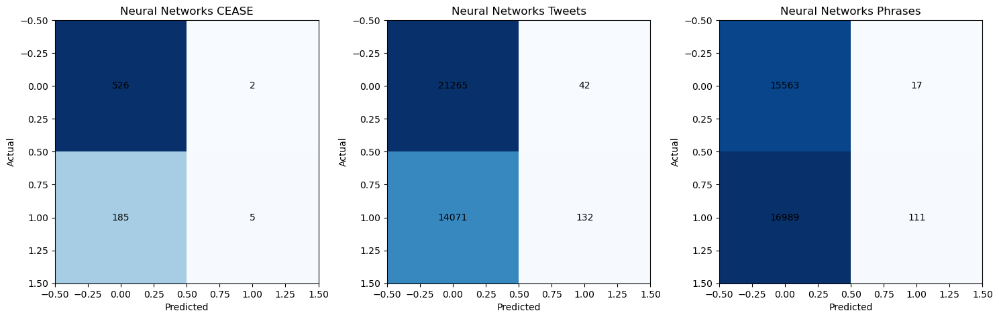

In [25]:
# Call the function for CEASE dataset
cease_outputs, best_model = train_test_neural_network(X_train, y_train, X_test, y_test)

# Call the function to print all the metrics and visualizations
df_cease_neural, df_tweets_neural, df_phrases_neural, df_metrics_neural = evaluate_model(cease_outputs, best_model, 'Neural Networks')

## Support Vector Machines

Support Vector Machines (SVMs) are versatile models for classification and regression tasks. They find the best hyperplane to separate classes, even in high-dimensional or nonlinear data, using a margin-maximizing approach. SVMs are widely used in fields like image recognition and text classification for their efficiency and flexibility.

In [26]:
def train_test_svc_classifier(X_train, y_train, X_test, y_test):
    # Define a pipeline with preprocessing and the SVC model
    pipeline = Pipeline([
        ('vectorizer', TfidfVectorizer()),
        ('model', SVC())
    ])

    # Parameters for GridSearch with CountVectorizer
    parameters = {
        'vectorizer__max_features': [1000, 5000],
        'vectorizer__ngram_range': [(1, 1), (1, 2)],
        'model__C': [0.01, 0.1, 1, 10],
        'model__kernel': ['linear', 'rbf', 'sigmoid'],
        'model__gamma': ['scale', 'auto']
    }

    # Set up the grid search with cross-validation
    grid_search = GridSearchCV(pipeline, parameters, cv=5, n_jobs=-1)

    # Train the model
    grid_search.fit(X_train, y_train)

    # Obtain best model from grid search
    best_model = grid_search.best_estimator_

    # Obtain outputs for testing instances
    test_outputs = best_model.predict(X_test)

    return test_outputs, best_model

                Classifier  Accuracy  Precision    Recall  F1-score  \
0  Support Vector Machines  0.772981   0.775264  0.973485  0.863140   
1  Support Vector Machines  0.614109   0.612752  0.969728  0.750977   
2  Support Vector Machines  0.497491   0.486534  0.976316  0.649432   

   Roc-Auc_Score  
0       0.594637  
1       0.525173  
2       0.518772  


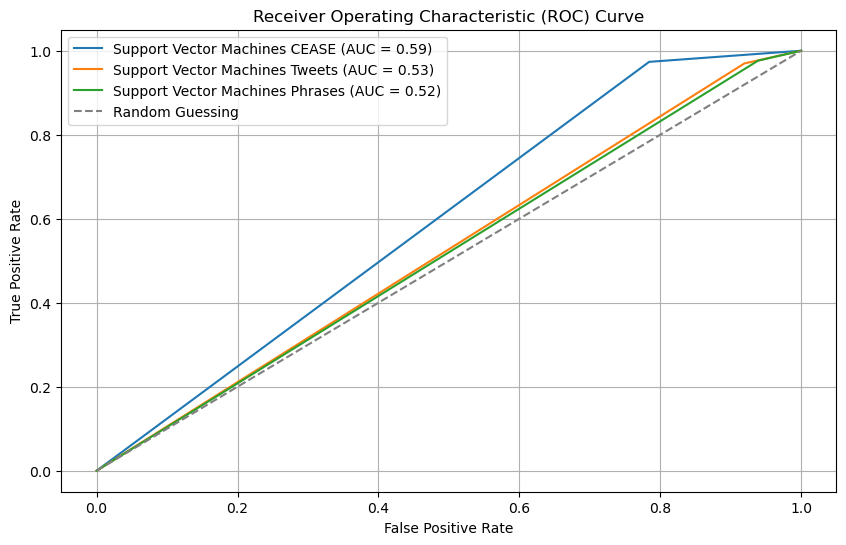

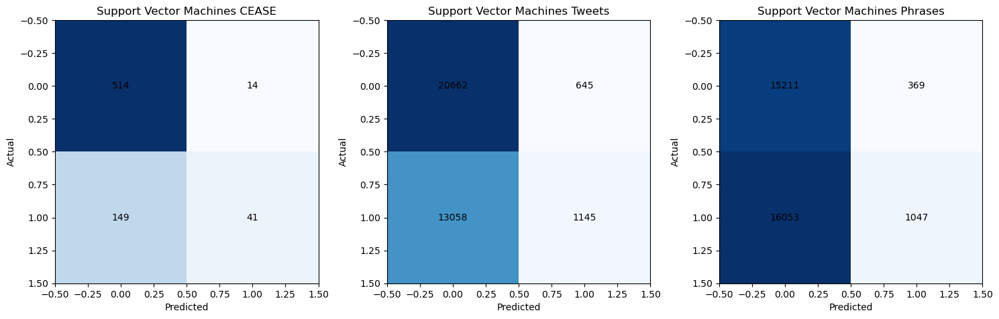

In [27]:
# Call the function for CEASE dataset
cease_outputs, best_model = train_test_svc_classifier(X_train, y_train, X_test, y_test)

# Call the function to print all the metrics and visualizations
df_cease_svm, df_tweets_svm, df_phrases_svm, df_metrics_svm = evaluate_model(cease_outputs, best_model, 'Support Vector Machines')

## Random Forest

Random Forest is an ensemble learning method used for classification, regression, and other tasks. It operates by constructing multiple decision trees during training and outputting the class that is the mode of the classes (classification) or mean prediction (regression) of the individual trees. Each tree in the forest is built from a random subset of the training data and features, which helps to reduce overfitting and improve generalization. Random Forest is robust to noise and can handle large datasets with higher dimensionality. It is widely used due to its simplicity, flexibility, and strong performance across various tasks.

In [28]:
def train_test_random_forest(X_train, y_train, X_test, y_test):
    # Define a pipeline with preprocessing and the RandomForestClassifier model
    pipeline = Pipeline([
        ('vectorizer', TfidfVectorizer()),
        ('model', RandomForestClassifier())
    ])

    # Parameters for GridSearch with TfidfVectorizer
    parameters = {
        'vectorizer__max_features': [1000, 5000],
        'vectorizer__ngram_range': [(1, 1), (1, 2)],
        'model__n_estimators': [100, 200],
        'model__max_depth': [None, 10, 20],
        'model__min_samples_split': [2, 5],
        'model__min_samples_leaf': [1, 2]
    }

    # Set up the grid search with cross-validation
    grid_search = GridSearchCV(pipeline, parameters, cv=5, n_jobs=-1)

    # Train the model
    grid_search.fit(X_train, y_train)

    # Obtain best model from grid search
    best_model = grid_search.best_estimator_

    # Obtain outputs for testing instances
    test_outputs = best_model.predict(X_test)

    return test_outputs, best_model

      Classifier  Accuracy  Precision    Recall  F1-score  Roc-Auc_Score
0  Random Forest  0.760446   0.775542  0.948864  0.853492       0.592853
1  Random Forest  0.620642   0.616607  0.972357  0.754658       0.532683
2  Random Forest  0.501836   0.488770  0.977728  0.651735       0.522987


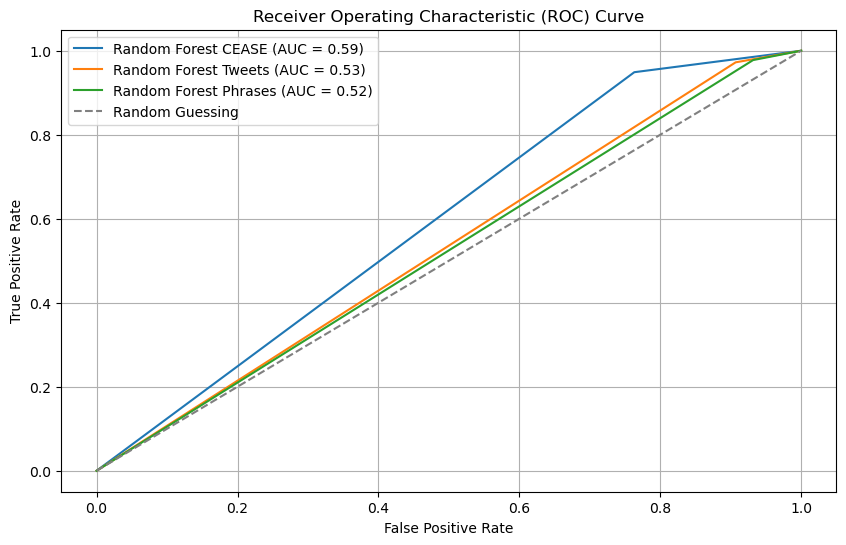

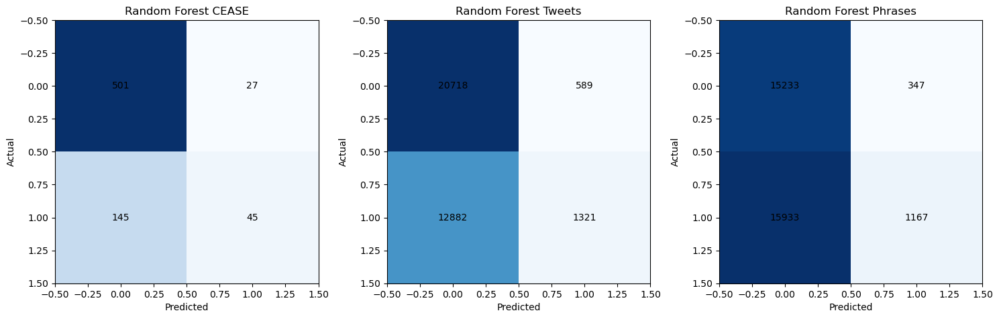

In [29]:
# Call the function for CEASE dataset
cease_outputs, best_model = train_test_random_forest(X_train, y_train, X_test, y_test)

# Call the function to print all the metrics and visualizations
df_cease_forest, df_tweets_forest, df_phrases_forest, df_metrics_forest = evaluate_model(cease_outputs, best_model, 'Random Forest')

## AdaBoost

AdaBoost, short for Adaptive Boosting, is an ensemble learning technique that combines multiple weak classifiers to form a strong classifier. It works by sequentially training weak classifiers, typically decision stumps, and adjusting the weights of misclassified instances so that subsequent classifiers focus more on difficult cases. Each classifier is assigned a weight based on its accuracy, and the final prediction is a weighted vote of all classifiers. AdaBoost is effective at improving the accuracy of weak models and is less prone to overfitting compared to some other ensemble methods. It is commonly used in classification tasks where model interpretability and performance are important.

In [30]:
def train_test_adaboost(X_train, y_train, X_test, y_test):
    # Define a pipeline with preprocessing and the AdaBoostClassifier model
    pipeline = Pipeline([
        ('vectorizer', TfidfVectorizer()),
        ('model', AdaBoostClassifier())
    ])

    # Parameters for GridSearch with TfidfVectorizer
    parameters = {
        'vectorizer__max_features': [1000, 5000],
        'vectorizer__ngram_range': [(1, 1), (1, 2)],
        'model__n_estimators': [50, 100, 200],
        'model__learning_rate': [0.01, 0.1, 1, 10]
    }

    # Set up the grid search with cross-validation
    grid_search = GridSearchCV(pipeline, parameters, cv=5, n_jobs=-1)

    # Train the model
    grid_search.fit(X_train, y_train)

    # Obtain best model from grid search
    best_model = grid_search.best_estimator_

    # Obtain outputs for testing instances
    test_outputs = best_model.predict(X_test)

    return test_outputs, best_model

  Classifier  Accuracy  Precision    Recall  F1-score  Roc-Auc_Score
0   AdaBoost  0.754875   0.759587  0.975379  0.854063       0.558742
1   AdaBoost  0.611771   0.609288  0.983949  0.752567       0.518694
2   AdaBoost  0.496542   0.486153  0.983633  0.650702       0.518191


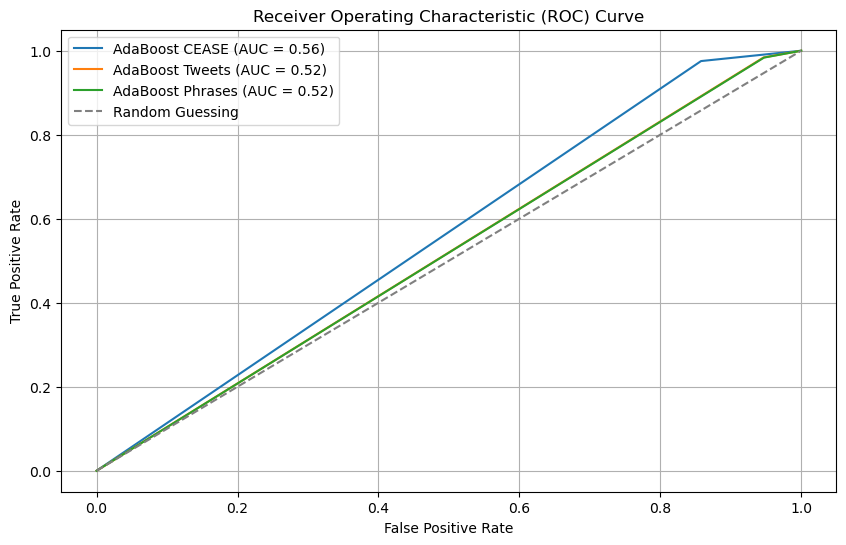

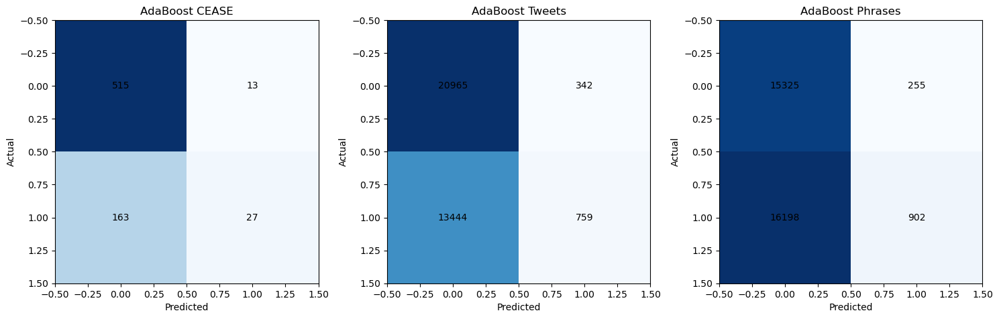

In [31]:
# Call the function for CEASE dataset
cease_outputs, best_model = train_test_adaboost(X_train, y_train, X_test, y_test)

# Call the function to print all the metrics and visualizations
df_cease_adaboost, df_tweets_adaboost, df_phrases_adaboost, df_metrics_adaboost = evaluate_model(cease_outputs, best_model, 'AdaBoost')

## One-Vs-One

OVO Classifier is a strategy for multi-class classification where pairwise classifiers are trained for each pair of classes. During prediction, the class that wins the most pairwise duels is chosen. OVO is suitable for problems with multiple classes and provides robust classification performance.

In [32]:
def train_test_one_vs_one_classifier(X_train, y_train, X_test, y_test):
    # Define a pipeline with preprocessing and the OneVsOneClassifier model
    pipeline = Pipeline([
        ('vectorizer', TfidfVectorizer()),
        ('model', OneVsOneClassifier(SVC()))
    ])

    # Parameters for GridSearch with TfidfVectorizer
    parameters = {
        'vectorizer__max_features': [1000, 5000],
        'vectorizer__ngram_range': [(1, 1), (1, 2)],
        'model__estimator__C': [0.01, 0.1, 1, 10],
        'model__estimator__kernel': ['linear', 'rbf', 'sigmoid'],
        'model__estimator__gamma': ['scale', 'auto']
    }

    # Set up the grid search with cross-validation
    grid_search = GridSearchCV(pipeline, parameters, cv=5, n_jobs=-1)

    # Train the model
    grid_search.fit(X_train, y_train)

    # Obtain best model from grid search
    best_model = grid_search.best_estimator_

    # Obtain outputs for testing instances
    test_outputs = best_model.predict(X_test)

    return test_outputs, best_model

  Classifier  Accuracy  Precision    Recall  F1-score  Roc-Auc_Score
0        OVO  0.772981   0.775264  0.973485  0.863140       0.594637
1        OVO  0.614109   0.612752  0.969728  0.750977       0.525173
2        OVO  0.497491   0.486534  0.976316  0.649432       0.518772


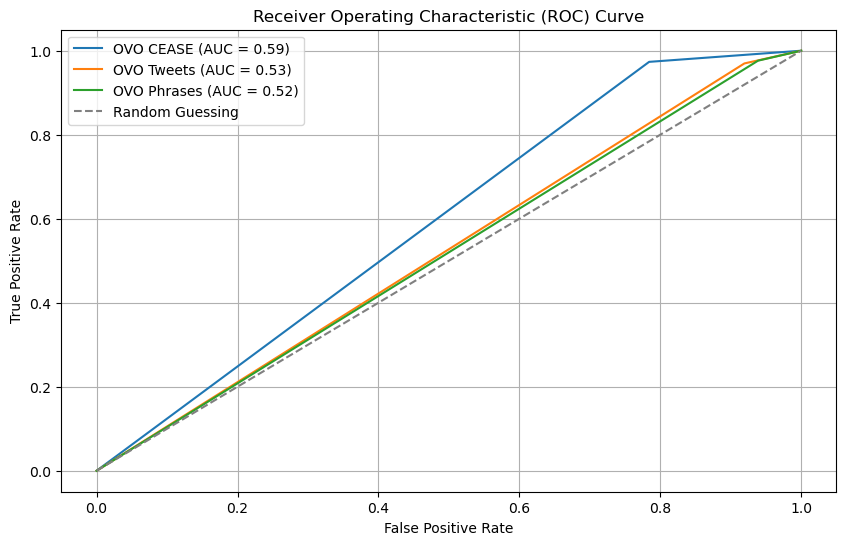

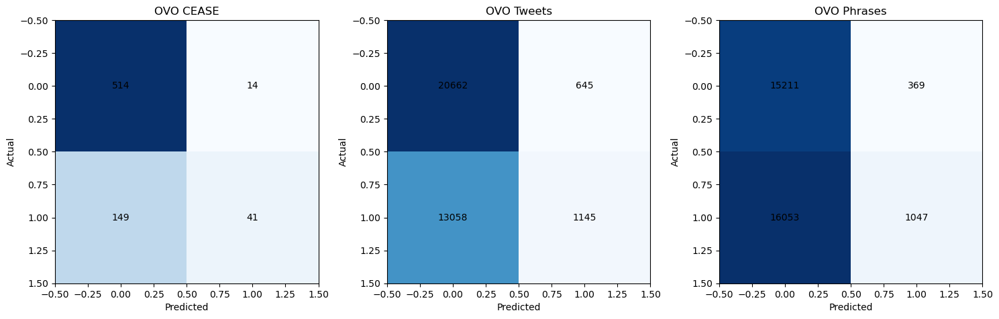

In [33]:
# Call the function for CEASE dataset
cease_outputs, best_model = train_test_one_vs_one_classifier(X_train, y_train, X_test, y_test)

# Call the function to print all the metrics and visualizations
df_cease_ovo, df_tweets_ovo, df_phrases_ovo, df_metrics_ovo = evaluate_model(cease_outputs, best_model, 'OVO')

## One-Vs-All

OVA Classifier is another strategy for multi-class classification where binary classifiers are trained to distinguish each class from all others. During prediction, the class with the highest confidence score from its corresponding binary classifier is chosen. OVA is widely used and straightforward to implement for multi-class classification tasks.

In [34]:
def train_test_one_vs_all_classifier(X_train, y_train, X_test, y_test):
    # Define a pipeline with preprocessing and the OneVsRestClassifier model
    pipeline = Pipeline([
        ('vectorizer', TfidfVectorizer()),
        ('model', OneVsRestClassifier(SVC()))
    ])

    # Parameters for GridSearch with TfidfVectorizer
    parameters = {
        'vectorizer__max_features': [1000, 5000],
        'vectorizer__ngram_range': [(1, 1), (1, 2)],
        'model__estimator__C': [0.01, 0.1, 1, 10],
        'model__estimator__kernel': ['linear', 'rbf', 'sigmoid'],
        'model__estimator__gamma': ['scale', 'auto']
    }

    # Set up the grid search with cross-validation
    grid_search = GridSearchCV(pipeline, parameters, cv=5, n_jobs=-1)

    # Train the model
    grid_search.fit(X_train, y_train)

    # Obtain best model from grid search
    best_model = grid_search.best_estimator_

    # # Obtain outputs for training instances
    # train_outputs = best_model.predict(X_train)
    # # Obtain training accuracy using metrics.accuracy_score (train_acc)
    # train_acc = metrics.accuracy_score(y_train, train_outputs)

    # Obtain outputs for testing instances
    test_outputs = best_model.predict(X_test)
    # # Obtain testing accuracy using metrics.accuracy_score (test_acc)
    # test_acc = metrics.accuracy_score(y_test, test_outputs)

    return test_outputs, best_model

  Classifier  Accuracy  Precision    Recall  F1-score  Roc-Auc_Score
0        OVA  0.772981   0.775264  0.973485  0.863140       0.594637
1        OVA  0.614109   0.612752  0.969728  0.750977       0.525173
2        OVA  0.497491   0.486534  0.976316  0.649432       0.518772


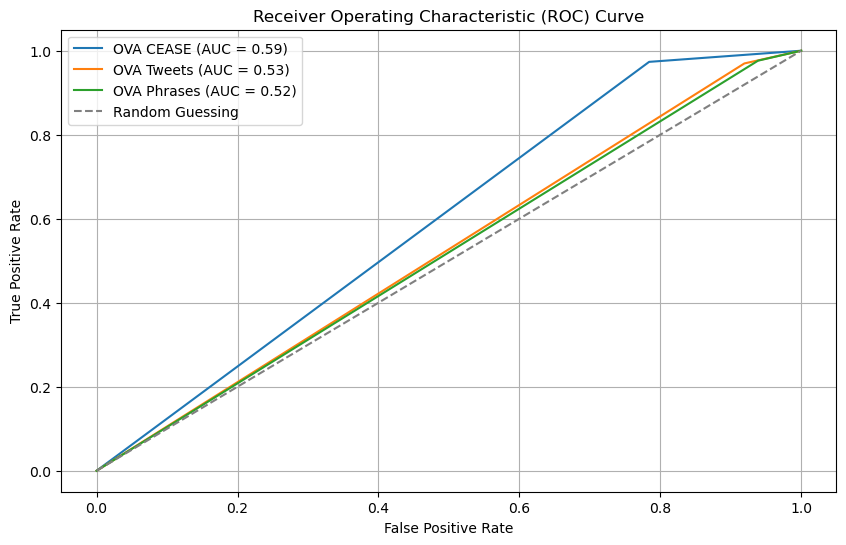

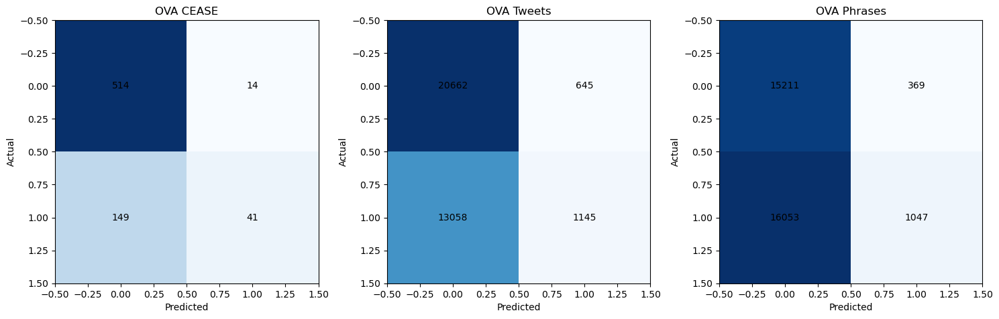

In [35]:
# Call the function for CEASE dataset
cease_outputs, best_model = train_test_one_vs_all_classifier(X_train, y_train, X_test, y_test)

# Call the function to print all the metrics and visualizations
df_cease_ova, df_tweets_ova, df_phrases_ova, df_metrics_ova = evaluate_model(cease_outputs, best_model, 'OVA')

Comparison between the different classifiers

In [36]:
# Combine the DataFrames
df_combined_metrics = pd.concat([df_metrics_naive, df_metrics_logistic, df_metrics_neural, df_metrics_svm, df_metrics_forest, df_metrics_adaboost], ignore_index=True)
df_combined_cease = pd.concat([df_cease_naive, df_cease_logistic, df_cease_neural, df_cease_svm, df_cease_forest, df_cease_adaboost], ignore_index=True)
df_combined_tweets = pd.concat([df_tweets_naive, df_tweets_logistic, df_tweets_neural, df_tweets_svm, df_tweets_forest, df_tweets_adaboost], ignore_index=True)
df_combined_phrases = pd.concat([df_phrases_naive, df_phrases_logistic, df_phrases_neural, df_phrases_svm, df_phrases_forest, df_phrases_adaboost], ignore_index=True)

# Print the combined DataFrame
print(df_combined_metrics)
print(df_combined_cease)
print(df_combined_tweets)
print(df_combined_phrases)

                 Classifier  Accuracy  Precision    Recall  F1-score  \
0               Naive Bayes  0.764624   0.769115  0.971591  0.858577   
1               Naive Bayes  0.608110   0.609150  0.967945  0.747734   
2               Naive Bayes  0.495594   0.485503  0.971566  0.647461   
3       Logistic Regression  0.760446   0.757225  0.992424  0.859016   
4       Logistic Regression  0.608110   0.609150  0.967945  0.747734   
5       Logistic Regression  0.495594   0.485503  0.971566  0.647461   
6           Neural Networks  0.739554   0.739803  0.996212  0.849072   
7           Neural Networks  0.602563   0.601794  0.998029  0.750843   
8           Neural Networks  0.479621   0.478097  0.998909  0.646680   
9   Support Vector Machines  0.772981   0.775264  0.973485  0.863140   
10  Support Vector Machines  0.614109   0.612752  0.969728  0.750977   
11  Support Vector Machines  0.497491   0.486534  0.976316  0.649432   
12            Random Forest  0.760446   0.775542  0.948864  0.85

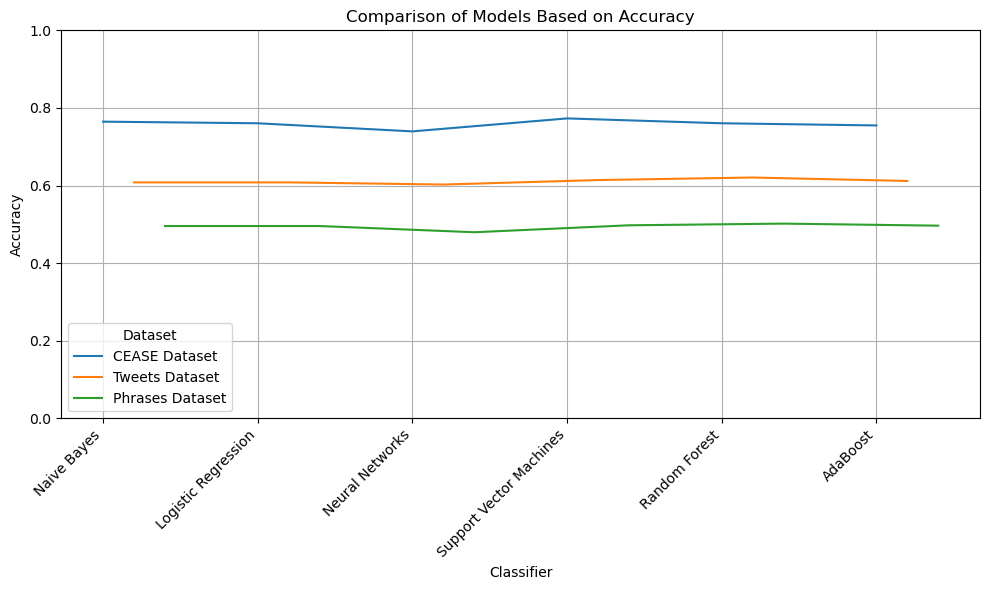

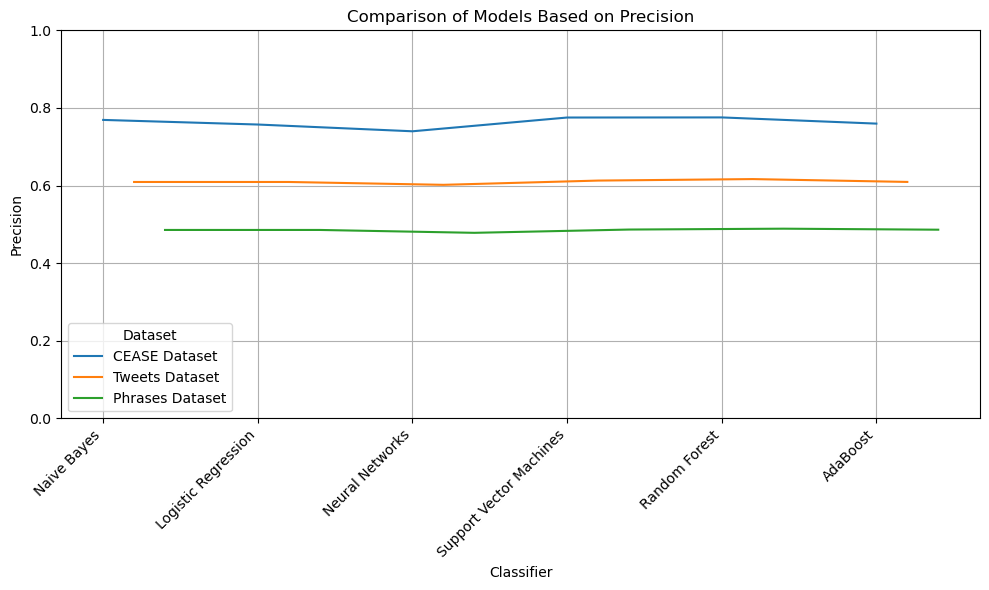

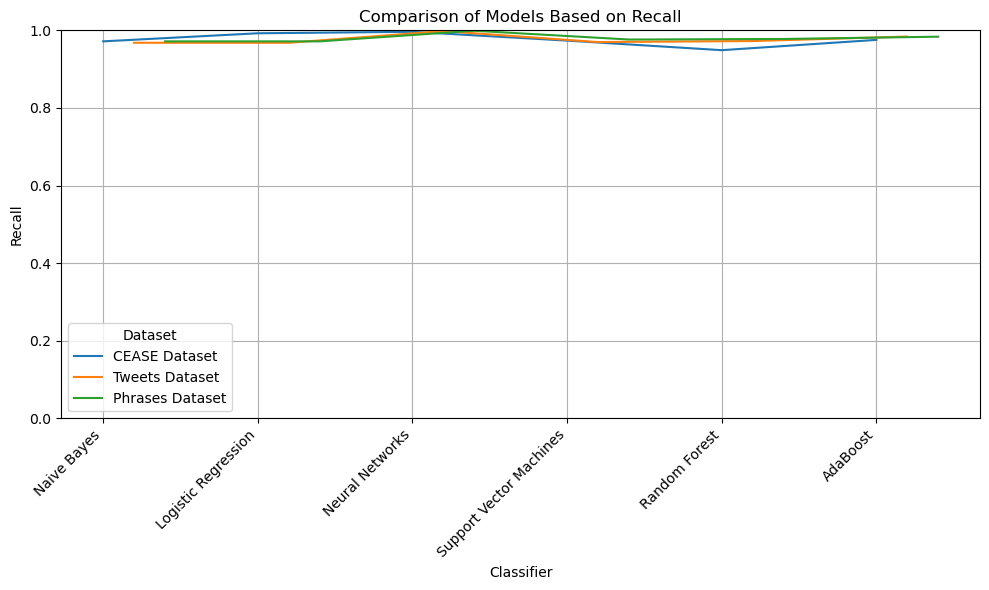

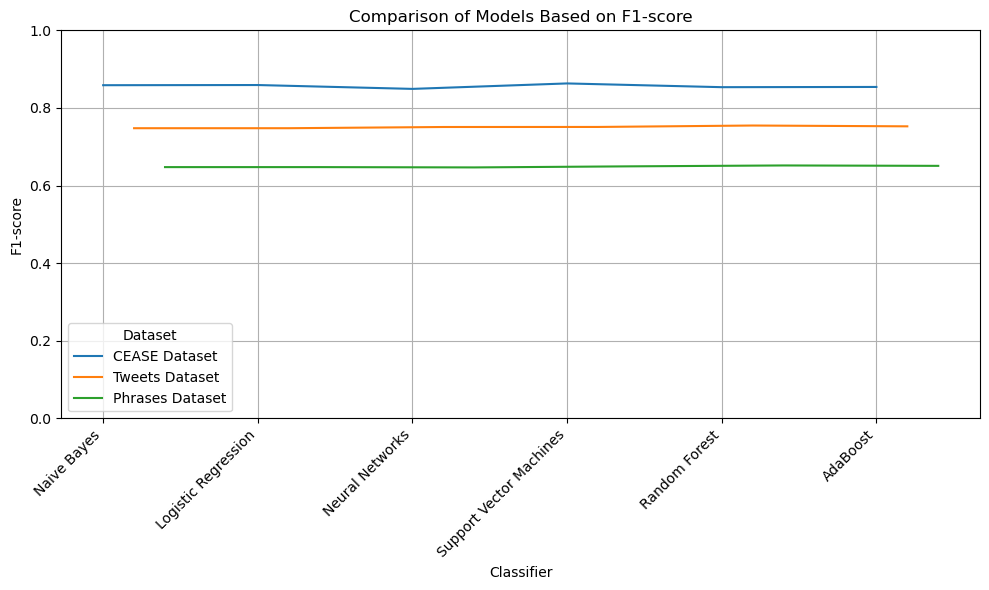

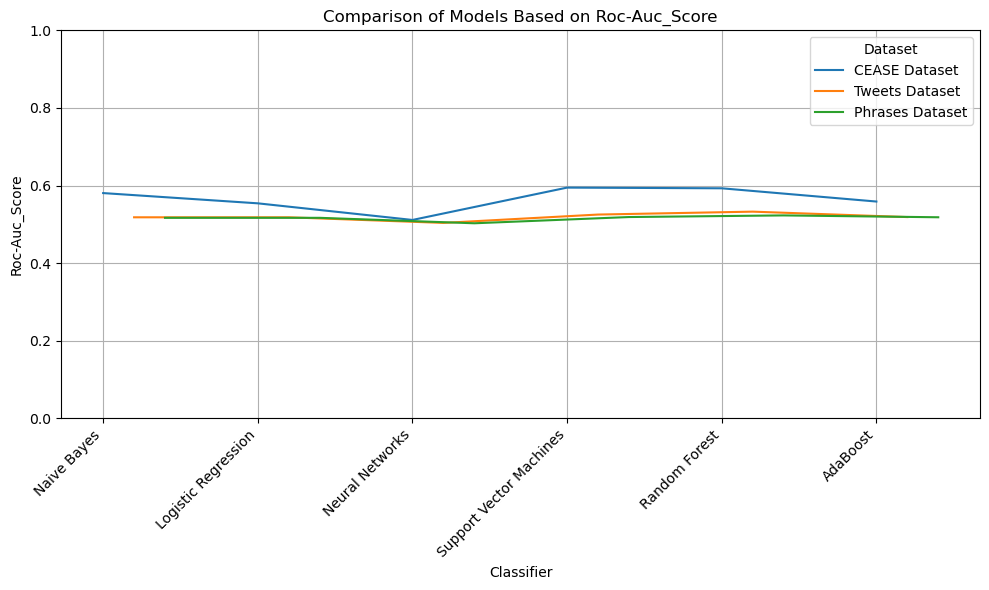

In [37]:
# Block the warning
warnings.filterwarnings("ignore", message="use_inf_as_na option is deprecated", category=FutureWarning)

# Names of the models
model_names = ['CEASE Dataset', 'Tweets Dataset', 'Phrases Dataset']
# Dataframes of the models combined
df_models = [df_combined_cease, df_combined_tweets, df_combined_phrases]
# Create modified x-values for each model
x_values = np.arange(len(df_combined_cease['Classifier']))

# Plotting function
def plot_metric(metric):
    plt.figure(figsize=(10, 6))
    for i, df_model in enumerate(df_models):
        sns.lineplot(data=df_model, x=x_values + i * 0.2, y=metric, label=model_names[i])
    plt.title(f'Comparison of Models Based on {metric}')
    plt.ylabel(metric)
    plt.ylim(0, 1)
    plt.xlabel('Classifier')
    plt.xticks(ticks=x_values, labels=df_combined_cease['Classifier'], rotation=45, ha='right')
    plt.legend(title='Dataset')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Plot each metric
metrics = ['Accuracy', 'Precision', 'Recall', 'F1-score', 'Roc-Auc_Score']
for metric in metrics:
    plot_metric(metric)

We make an example with some phrases to see if they are predicted correctly.

In [57]:
############################## EXAMPLE OF USE OF THE LOGISTIC REGRESSION MODEL IN A TEST DATASET ##############################

# Create the data of example
data = {
    "Text": [
        "I am sorry for all that I have done to us.",
        "So much pressure is put on the students every day that I could not do it anymore.",
        "I am sorry to disappoint my family.",
        "I am deeply sorry for you.",
        "I'm really excited about the new project at work!",
        "Spending time with friends always lifts my spirits.",
        "Today was a great day filled with laughter and joy.",
        "I'm looking forward to trying out that new recipe tonight."
    ],
    "label": [-1,-1,-1,-1,1,1,1,1]
}

# Create the DataFrame of example
df_example = pd.DataFrame(data)

# Example usage with test phrases
X_lemmatized_example = []

# Loop through each entry in the Example dataset
for index, row in df_example.iterrows():
    # Fix contractions in the text
    word_without_contractions = contractions.fix(row['Text'])
    print(word_without_contractions)
    
    # Replace usernames with a special token that preserves the '@' symbol
    word_without_usernames = re.sub(r'@(\w+)', r'USERNAME_TOKEN', word_without_contractions)
    print(word_without_usernames)
    
    # Tokenize the text into words
    tokenized = word_tokenize(word_without_usernames)
    print(tokenized)

    # Normalize the tokenized text
    normalized = normalize(tokenized)
    print(normalized)

    # Lemmatize the normalized text
    lemmatized = lemmatize(normalized)
    print(lemmatized)

    # Join the lemmatized words into a single string and append to X_lemmatized_example list
    X_lemmatized_example.append(" ".join(lemmatized))

# Convert the list of lemmatized texts into a numpy array with dtype 'str'
X_lemmatized_example = np.array(X_lemmatized_example, dtype=str)
print(X_lemmatized_example)

# We extract the labels from the DataFrame
labels_example = df_example['label']

# Obtain outputs for testing instances with the LogisticRegression model trained
example_outputs = best_model_logistic.predict(X_lemmatized_example)

print(example_outputs)

I am sorry for all that I have done to us.
I am sorry for all that I have done to us.
['I', 'am', 'sorry', 'for', 'all', 'that', 'I', 'have', 'done', 'to', 'us', '.']
['sorry', 'done', 'us']
['sorry', 'done', 'u']
So much pressure is put on the students every day that I could not do it anymore.
So much pressure is put on the students every day that I could not do it anymore.
['So', 'much', 'pressure', 'is', 'put', 'on', 'the', 'students', 'every', 'day', 'that', 'I', 'could', 'not', 'do', 'it', 'anymore', '.']
['much', 'pressure', 'put', 'students', 'every', 'day', 'could', 'anymore']
['much', 'pressure', 'put', 'student', 'every', 'day', 'could', 'anymore']
I am sorry to disappoint my family.
I am sorry to disappoint my family.
['I', 'am', 'sorry', 'to', 'disappoint', 'my', 'family', '.']
['sorry', 'disappoint', 'family']
['sorry', 'disappoint', 'family']
I am deeply sorry for you.
I am deeply sorry for you.
['I', 'am', 'deeply', 'sorry', 'for', 'you', '.']
['deeply', 'sorry']
['deepl